<a href="https://colab.research.google.com/github/HaleyEgan/Music-Generation-with-RNNs/blob/main/Music_Generation_with_RNNs.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Music Generation with RNNs

Charles Darwin once said, “If I had my life to live over again, I would have made a rule to read some poetry and listen to some music at least once every week.” As humans, we all like to listen to music to relax, destress, and recreate. Essentially, music consists of a sequence of musical notes.

For this project, I explored building a Recurrent Neural Network (RNN) for music generation. I trained a model to learn the patterns in raw sheet music in [ABC notation](https://en.wikipedia.org/wiki/ABC_notation) and then used this model to generate new music. This project was adapted from the MIT Deep Learning Lab. I utilized Google Colab notebooks for the project. 

## 1. Dependencies 
First, download the repository, install dependencies, and import the relevant packages.

In [1]:
# Import Tensorflow 2.0
%tensorflow_version 2.x
import tensorflow as tf 

# Download and import the MIT 6.S191 package
!pip install mitdeeplearning
import mitdeeplearning as mdl

# Import all remaining packages
import numpy as np
import os
import time
import functools
from IPython import display as ipythondisplay
from tqdm import tqdm
!apt-get install abcmidi timidity > /dev/null 2>&1

# Check if using a GPU, if not switch runtimes
#   using Runtime > Change Runtime Type > GPU
assert len(tf.config.list_physical_devices('GPU')) > 0

Colab only includes TensorFlow 2.x; %tensorflow_version has no effect.
Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     |████████████████████████████████| 2.1 MB 5.3 MB/s 
  Created wheel for mitdeeplearning: filename=mitdeeplearning-0.2.0-py3-none-any.whl size=2115442 sha256=c968cb823aca024290491f6aa17b2b055064d93f38c93bebeb92336febbc2066
  Stored in directory: /root/.cache/pip/wheels/9a/b9/4f/99b7c8c5c75355550b83e1fcfc02956fb40c35eb01e2262877
Successfully built mitdeeplearning


## 2. Dataset

Download and inspect dataset of thousands of Irish folk songs, represented in the ABC notation. 


In [2]:
# Download the dataset
songs = mdl.lab1.load_training_data()

# Print one of the songs to inspect it in greater detail!
example_song = songs[0]
print("\nExample song: ")
print(example_song)

Found 817 songs in text

Example song: 
X:1
T:Alexander's
Z: id:dc-hornpipe-1
M:C|
L:1/8
K:D Major
(3ABc|dAFA DFAd|fdcd FAdf|gfge fefd|(3efe (3dcB A2 (3ABc|!
dAFA DFAd|fdcd FAdf|gfge fefd|(3efe dc d2:|!
AG|FAdA FAdA|GBdB GBdB|Acec Acec|dfaf gecA|!
FAdA FAdA|GBdB GBdB|Aceg fefd|(3efe dc d2:|!


Convert a song in ABC notation to an audio waveform and play it back. 

In [3]:
# Convert the ABC notation to audio file and listen to it
mdl.lab1.play_song(example_song)

This notation of music does not simply contain information on the notes being played, but also meta information such as the song title, key, and tempo. 

In [4]:
# Join list of song strings into a single string containing all songs
songs_joined = "\n\n".join(songs) 

# Find all unique characters in the joined string
vocab = sorted(set(songs_joined))
print("There are", len(vocab), "unique characters in the dataset")

There are 83 unique characters in the dataset


## 3. Process the dataset for the learning task

The goal is to train a RNN model to learn patterns in ABC music, and then use this model to generate (i.e., predict) a new piece of music based on this learned information. 

What we're asking the model is: given a character, or a sequence of characters, what is the most probable next character? The goal is to train the model to perform this task, by inputing a sequence of characters to the model, and training the model to predict the output (the following character at each time step). RNNs maintain an internal state that depends on previously seen elements, so information about all characters seen up until a given moment will be taken into account in generating the prediction.

### Vectorize the text

Create a numerical representation of the text-based dataset. Generate two lookup tables: one that maps characters to numbers, and a second that maps numbers back to characters. 

In [5]:
### Define numerical representation of text ###

# Create a mapping from character to unique index.
# For example, to get the index of the character "d", evaluate `char2idx["d"]`  
char2idx = {u:i for i, u in enumerate(vocab)}

# Create a mapping from indices to characters. This is
#   the inverse of char2idx and allows us to convert back
#   from unique index to the character in our vocabulary.
idx2char = np.array(vocab)

In [6]:
char2idx['d']

59

In [7]:
idx2char[59]

'd'

This gives an integer representation for each character. The unique characters (i.e., vocabulary) in the text are mapped as indices from 0 to `len(unique)`.

In [8]:
# look at numerical representation of dataset
print('{')
for char,_ in zip(char2idx, range(20)):
    print('  {:4s}: {:3d},'.format(repr(char), char2idx[char]))
print('  ...\n}')

{
  '\n':   0,
  ' ' :   1,
  '!' :   2,
  '"' :   3,
  '#' :   4,
  "'" :   5,
  '(' :   6,
  ')' :   7,
  ',' :   8,
  '-' :   9,
  '.' :  10,
  '/' :  11,
  '0' :  12,
  '1' :  13,
  '2' :  14,
  '3' :  15,
  '4' :  16,
  '5' :  17,
  '6' :  18,
  '7' :  19,
  ...
}


In [9]:
### Vectorize the songs string ###

'''A function to convert the all-songs string to a vectorized
    (i.e., numeric) representation. Use mapping above to convert from vocab
    characters to corresponding indices.

  NOTE: the output of the `vectorize_string` function 
  should be a np.array with `N` elements, where `N` is
  the number of characters in the input string
'''
def vectorize_string(string):
  vectorized_output = np.array([char2idx[char] for char in string])
  return vectorized_output

vectorized_songs = vectorize_string(songs_joined)

In [10]:
vectorized_songs

array([49, 22, 13, ..., 22, 82,  2])

Look at how the first part of the text is mapped to an integer representation:

In [11]:
print ('{} ---- characters mapped to int ----> {}'.format(repr(songs_joined[:10]), 
                                                          vectorized_songs[:10]))
# check that vectorized_songs is a numpy array
assert isinstance(vectorized_songs, np.ndarray), "returned result should be a numpy array"

'X:1\nT:Alex' ---- characters mapped to int ----> [49 22 13  0 45 22 26 67 60 79]


### Create training examples and targets

Next, divide the text into example sequences for use during training. Each input sequence that is fed into the RNN will contain `seq_length` characters from the text. Define a target sequence for each input sequence for use in training the RNN to predict the next character. For each input, the corresponding target will contain the same length of text, except shifted one character to the right.

Break the text into chunks of `seq_length+1`. Suppose `seq_length` is 4 and the text is "Hello". Then, our input sequence is "Hell" and the target sequence is "ello".

The batch method will then let us convert this stream of character indices to sequences of the desired size.

In [12]:
### Batch definition to create training examples ###
# convert stream of character indices to sequences of the desired size
# vectorized_songs = all songs string to a vectorize (i.e., numeric) representation
# seq_length = length of input sequence for training
# batch_size = size of batch

def get_batch(vectorized_songs, seq_length, batch_size):
  # the length of the vectorized songs string
  n = vectorized_songs.shape[0] - 1
  # randomly choose the starting indices for the examples in the training batch
  idx = np.random.choice(n-seq_length, batch_size)

  #Construct a list of input sequences for the training batch
  #ex: [[14 26 82  2  0 30 26 26  1 26][ 1 30 32 29 32 82 27 32 26 32]]
  #break text into chunks of seq_length
  input_batch = [vectorized_songs[i:i+seq_length] for i in idx]

  #Construct a list of output sequences for the training batch
  #target sequence #seq_length+1 
  output_batch = [vectorized_songs[i+1: i+seq_length+1] for i in idx]

  # x_batch, y_batch provide the true inputs and targets for network training
  x_batch = np.reshape(input_batch, [batch_size, seq_length])
  y_batch = np.reshape(output_batch, [batch_size, seq_length])
  return x_batch, y_batch

# Perform some simple tests to make sure your batch function is working properly
test_args = (vectorized_songs, 10, 2)
if not mdl.lab1.test_batch_func_types(get_batch, test_args) or \
   not mdl.lab1.test_batch_func_shapes(get_batch, test_args) or \
   not mdl.lab1.test_batch_func_next_step(get_batch, test_args): 
   print("======\n[FAIL] could not pass tests")
else: 
   print("======\n[PASS] passed all tests!")

[PASS] test_batch_func_types
[PASS] test_batch_func_shapes
[PASS] test_batch_func_next_step
[PASS] passed all tests!


For each of these vectors, each index is processed at a single time step. So, for the input at time step 0, the model receives the index for the first character in the sequence, and tries to predict the index of the next character. At the next timestep, it does the same thing, but the RNN considers the information from the previous step, i.e., its updated state, in addition to the current input.

Look at how this works over the first several characters in the text:

In [13]:
x_batch, y_batch = get_batch(vectorized_songs, seq_length=5, batch_size=1)

for i, (input_idx, target_idx) in enumerate(zip(np.squeeze(x_batch), np.squeeze(y_batch))):
    print("Step {:3d}".format(i))
    print("  input: {} ({:s})".format(input_idx, repr(idx2char[input_idx])))
    print("  expected output: {} ({:s})".format(target_idx, repr(idx2char[target_idx])))

Step   0
  input: 59 ('d')
  expected output: 82 ('|')
Step   1
  input: 82 ('|')
  expected output: 60 ('e')
Step   2
  input: 60 ('e')
  expected output: 26 ('A')
Step   3
  input: 26 ('A')
  expected output: 1 (' ')
Step   4
  input: 1 (' ')
  expected output: 26 ('A')


## 4. The Recurrent Neural Network (RNN) model

Dfine and train a RNN model on the ABC music dataset, and then use that trained model to generate a new song. Train the RNN using batches of song snippets from the dataset, generated in the previous section.

The model is based off the LSTM architecture, where a state vector is used to maintain information about the temporal relationships between consecutive characters. The final output of the LSTM is then fed into a fully connected [`Dense`](https://www.tensorflow.org/api_docs/python/tf/keras/layers/Dense) layer where we output a softmax over each character in the vocabulary, and then sample from this distribution to predict the next character. 

Use the Keras API, specifically, [`tf.keras.Sequential`](https://www.tensorflow.org/api_docs/python/tf/keras/models/Sequential), to define the model. Three layers are used to define the model:

* [`tf.keras.layers.Embedding`](https://www.tensorflow.org/api_docs/python/tf/keras/layers/Embedding): This is the input layer, consisting of a trainable lookup table that maps the numbers of each character to a vector with `embedding_dim` dimensions.
* [`tf.keras.layers.LSTM`](https://www.tensorflow.org/api_docs/python/tf/keras/layers/LSTM): Our LSTM network, with size `units=rnn_units`. 
* [`tf.keras.layers.Dense`](https://www.tensorflow.org/api_docs/python/tf/keras/layers/Dense): The output layer, with `vocab_size` outputs.


### Define the RNN model

Define a function to build the model.

In [14]:
def LSTM(rnn_units): 
  return tf.keras.layers.LSTM(
    rnn_units, 
    return_sequences=True, 
    recurrent_initializer='glorot_uniform',
    recurrent_activation='sigmoid',
    stateful=True,
  )

Define the RNN model within the `build_model` function, and then call the function to instantiate the model.

In [15]:
### Defining the RNN Model ###

#Add LSTM and Dense layers to define the RNN model using the Sequential API.
def build_model(vocab_size, embedding_dim, rnn_units, batch_size):
  model = tf.keras.Sequential([
    # Layer 1: Embedding layer to transform indices into dense vectors 
      # of a fixed embedding size
    tf.keras.layers.Embedding(vocab_size, embedding_dim, batch_input_shape=[batch_size, None]),

    # Layer 2: LSTM with `rnn_units` number of units. 
    # Call the LSTM function defined above to add this layer.
    LSTM(rnn_units), 

    # Layer 3: Dense (fully-connected) layer that transforms the LSTM output
    #   into the vocabulary size. 
    # Add the Dense layer.
    tf.keras.layers.Dense(units=vocab_size) 
  ])
  return model

# Build a simple model with default hyperparameters.
model = build_model(len(vocab), embedding_dim=256, rnn_units=1024, batch_size=32)

In [16]:
model

### Test RNN model

Run a few simple checks on model.  

Use the `Model.summary` function to print out a summary of the model's internal workings. Check the layers in the model, the shape of the output of each of the layers, the batch size, etc.

In [17]:
model.summary()

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 embedding (Embedding)       (32, None, 256)           21248     
                                                                 
 lstm (LSTM)                 (32, None, 1024)          5246976   
                                                                 
 dense (Dense)               (32, None, 83)            85075     
                                                                 
Total params: 5,353,299
Trainable params: 5,353,299
Non-trainable params: 0
_________________________________________________________________


In [18]:
#Check the dimensionality of the output, using a sequence length of 100. 
#The model can be run on inputs of any length.
x, y = get_batch(vectorized_songs, seq_length=100, batch_size=32)
pred = model(x)
print("Input shape:      ", x.shape, " # (batch_size, sequence_length)")
print("Prediction shape: ", pred.shape, "# (batch_size, sequence_length, vocab_size)")

Input shape:       (32, 100)  # (batch_size, sequence_length)
Prediction shape:  (32, 100, 83) # (batch_size, sequence_length, vocab_size)


### Predictions from the untrained model

To get actual predictions from the model, sample from the output distribution, which is defined by a `softmax` over our character vocabulary. This will give actual character indices. This means we are using a [categorical distribution](https://en.wikipedia.org/wiki/Categorical_distribution) to sample over the example prediction. This gives a prediction of the next character (specifically its index) at each timestep.

Sample from probability distribution, as opposed to simply taking the `argmax`, which can cause the model to get stuck in a loop.

In [19]:
#sampling for the first example in the batch.
sampled_indices = tf.random.categorical(pred[0], num_samples=1)
sampled_indices = tf.squeeze(sampled_indices,axis=-1).numpy()
sampled_indices

array([30,  0, 37, 63, 24, 27,  1, 28,  9, 50, 36, 70,  2, 26, 57,  0,  3,
       15, 18, 24, 21, 20, 49, 10,  6, 46, 81, 16, 41, 18, 11, 38, 51, 10,
       53, 62, 33, 11, 25, 49, 42, 39, 78, 77, 18, 50, 41, 30, 37, 20, 49,
       16, 16, 37, 14, 23,  5, 31,  2, 39, 60, 64, 18, 35, 20, 55, 68, 40,
       82, 50, 52, 40, 82,  7, 24, 82, 29, 38, 71,  6, 26, 33, 31, 60,  6,
       13, 58, 34, 65, 42, 64, 41,  4,  8, 24, 17, 65, 52, 24,  7])

In [20]:
#Decode to see text predicted by the untrained model
print("Input: \n", repr("".join(idx2char[x[0]])))
print()
print("Next Char Predictions: \n", repr("".join(idx2char[sampled_indices])))

Input: 
 'ornpipe-55\nM:C|\nL:1/8\nK:F Major\n(3cde|f2cA BABc|AFGE F2fg|afba gafg|ecc=B c2cA|!\nBdgb Acfa|Gceg FAcf'

Next Char Predictions: 
 'E\nLh=B C-YKo!Ab\n"36=98X.(Uz4P6/MZ.]gH/>XQNwv6YPEL8X44L2<\'F!Nei6J8_mO|Y[O|)=|DMp(AHFe(1cIjQiP#,=5j[=)'


## 5. Training the model: loss and training operations

Given the previous state of the RNN, as well as the input at a given time step, we want to predict the next character. 

To train the model on this classification task, use a form of the `crossentropy` loss (negative log likelihood loss), `sparse_categorical_crossentropy` loss, as it utilizes integer targets for categorical classification tasks. Compute the loss using the true targets -- the `labels` -- and the predicted targets -- the `logits`. Compute the loss using example predictions from the untrained model. 

In [21]:
### Defining the loss function ###

''' Define the loss function to compute and return the loss between
    the true labels and predictions (logits). Set argument from_logits=True.'''
def compute_loss(labels, logits):
  loss = tf.keras.losses.sparse_categorical_crossentropy(labels, logits, from_logits=True)
  return loss

'''Compute loss using the true next characters from the example batch 
    and the predictions from the untrained model above'''
example_batch_loss = compute_loss(y, pred) 

print("Prediction shape: ", pred.shape, " # (batch_size, sequence_length, vocab_size)") 
print("scalar_loss:      ", example_batch_loss.numpy().mean())

Prediction shape:  (32, 100, 83)  # (batch_size, sequence_length, vocab_size)
scalar_loss:       4.4178176


In [22]:
### Hyperparameter setting and optimization ###

# Optimization parameters:
num_training_iterations = 2000  # Increase this to train longer
batch_size = 32  # Experiment between 1 and 64
seq_length = 100  # Experiment between 50 and 500
learning_rate = 0.001 # Experiment between 1e-5 and 1e-1

# Model parameters: 
vocab_size = len(vocab)
embedding_dim = 256 
rnn_units = 1000 # Experiment between 1 and 2048

# Checkpoint location: 
checkpoint_dir = './training_checkpoints'
checkpoint_prefix = os.path.join(checkpoint_dir, "my_ckpt")

Optimizers: [`Adam`](https://www.tensorflow.org/api_docs/python/tf/keras/optimizers/Adam?version=stable) and [`Adagrad`](https://www.tensorflow.org/api_docs/python/tf/keras/optimizers/Adagrad?version=stable). https://www.tensorflow.org/api_docs/python/tf/keras/optimizers/

[`tf.GradientTape`](https://www.tensorflow.org/api_docs/python/tf/GradientTape) method to perform the backpropagation operations. 



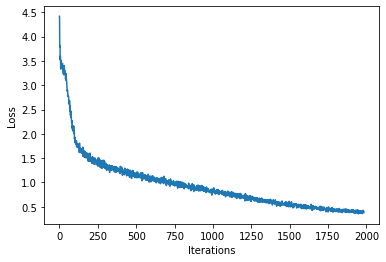

100%|██████████| 2000/2000 [01:28<00:00, 22.61it/s]


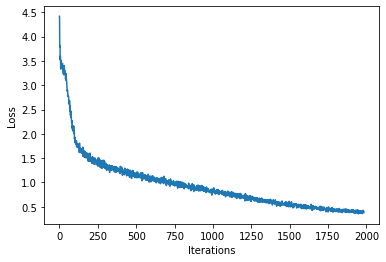

In [23]:
### Define optimizer and training operation ###

'''Instantiate a new model for training using the `build_model`
  function and the hyperparameters created above.'''
model = build_model(vocab_size, embedding_dim, rnn_units, batch_size)

'''Instantiate an optimizer with its learning rate.'''
optimizer = tf.keras.optimizers.Adam(learning_rate)

@tf.function
def train_step(x, y): 
  # Use tf.GradientTape()
  with tf.GradientTape() as tape:
    #Feed the current input into the model and generate predictions
    y_hat = model(x)
  
    #Compute loss
    loss = compute_loss(y, y_hat)

  #Compute the gradients 
  '''Complete the function call for gradient computation. 
      Remember that we want the gradient of the loss with respect all 
      of the model parameters. Use `model.trainable_variables` to 
      get a list of all model parameters.'''
  #pass in loss and model variables #error function and current state of variables
  #differentiate backward 
  #compute differential of gradient of loss with respect to each variable in each dimension
  #like auto_grad function - backbone of tensorflow/pytorch
  grads = tape.gradient(loss, model.trainable_variables)
  
  # Apply the gradients to the optimizer so it can update the model accordingly
  optimizer.apply_gradients(zip(grads, model.trainable_variables))
  return loss

##################
# Begin training!#
##################

# visualize whether or not we are minimizing the loss

history = []
plotter = mdl.util.PeriodicPlotter(sec=2, xlabel='Iterations', ylabel='Loss')
if hasattr(tqdm, '_instances'): tqdm._instances.clear() # clear if it exists

for iter in tqdm(range(num_training_iterations)):

  # Grab a batch and propagate it through the network
  x_batch, y_batch = get_batch(vectorized_songs, seq_length, batch_size)
  loss = train_step(x_batch, y_batch)

  # Update the progress bar
  history.append(loss.numpy().mean())
  plotter.plot(history)

  # Update the model with the changed weights!
  if iter % 100 == 0:     
    model.save_weights(checkpoint_prefix)
    
# Save the trained model and the weights
model.save_weights(checkpoint_prefix)


## 6. Generate music using the RNN model

Use the trained RNN model to generate music. Feed the model some sort of seed to get it started.

Once there's a generated seed, then iteratively predict each successive character using the trained RNN. Encode a generated song in the ABC format.
Then, write it to a file and listen!

### Restore the latest checkpoint

Use a batch size of 1. Because of how the RNN state is passed from timestep to timestep, the model will only be able to accept a fixed batch size once it is built. 

To run the model with a different `batch_size`, rebuild the model and restore the weights from the latest checkpoint, i.e., the weights after the last checkpoint during training.

In [24]:
# Rebuild the model using a batch_size=1
model = build_model(vocab_size, embedding_dim, rnn_units, batch_size=1)

# Restore the model weights for the last checkpoint after training
model.load_weights(tf.train.latest_checkpoint(checkpoint_dir))
model.build(tf.TensorShape([1, None]))

model.summary()

Model: "sequential_2"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 embedding_2 (Embedding)     (1, None, 256)            21248     
                                                                 
 lstm_2 (LSTM)               (1, None, 1000)           5028000   
                                                                 
 dense_2 (Dense)             (1, None, 83)             83083     
                                                                 
Total params: 5,132,331
Trainable params: 5,132,331
Non-trainable params: 0
_________________________________________________________________


### The prediction procedure

Write the code to generate text in the ABC music format:

* Initialize a "seed" start string and the RNN state, and set the number of characters we want to generate.

* Use the start string and the RNN state to obtain the probability distribution over the next predicted character.

* Sample from multinomial distribution to calculate the index of the predicted character. This predicted character is then used as the next input to the model.

* At each time step, the updated RNN state is fed back into the model, so that it now has more context in making the next prediction. After predicting the next character, the updated RNN states are again fed back into the model, which is how it learns sequence dependencies in the data, as it gets more information from the previous predictions.



In [25]:
### Prediction of a generated song ###

def generate_text(model, start_string, generation_length=1000):
  # Evaluation step (generating ABC text using the learned RNN model)

  # Convert the start string to numbers (vectorize)
  input_eval = [char2idx[s] for s in start_string]
  input_eval = tf.expand_dims(input_eval, 0)

  # Empty string to store our results
  text_generated = []

  # Here batch size == 1
  model.reset_states()
  tqdm._instances.clear()

  for i in tqdm(range(generation_length)):
      # Evaluate the inputs and generate the next character predictions
      predictions = model(input_eval)
      
      # Remove the batch dimension
      predictions = tf.squeeze(predictions, 0)
      
      # Use a multinomial distribution to sample
      predicted_id = tf.random.categorical(predictions, num_samples=1)[-1,0].numpy()

      # Pass prediction along with previous hidden state as next inputs to model
      input_eval = tf.expand_dims([predicted_id], 0)
      
      # Add the predicted character to the generated text
      text_generated.append(idx2char[predicted_id])
    
  return (start_string + ''.join(text_generated))

In [26]:
#Use the model and function defined above to generate ABC format text of length 1000
#ABC files start with "X" 
generated_text = generate_text(model, start_string="X", generation_length=1000)

100%|██████████| 1000/1000 [00:07<00:00, 139.93it/s]


### Play back the generated music!

Call function to convert ABC format text to an audio file, and then play that back to check out our generated music. Train longer if the resulting song is not long enough, or re-generating the song.

In [ ]:
### Play back generated songs ###

generated_songs = mdl.lab1.extract_song_snippet(generated_text)

for i, song in enumerate(generated_songs): 
  # Synthesize the waveform from a song
  waveform = mdl.lab1.play_song(song)

  # If its a valid song (correct syntax), lets play it! 
  if waveform:
    print("Generated song", i)
    ipythondisplay.display(waveform)

Found 3 songs in text
Generated song 0


Generated song 1


### Copyright Information
This project was adapted and modified from a lab of MIT 6.S191 under MIT license. 

In [ ]:
# Copyright 2020 MIT 6.S191 Introduction to Deep Learning. All Rights Reserved.
# 
# Licensed under the MIT License. You may not use this file except in compliance
# with the License. Use and/or modification of this code outside of 6.S191 must
# reference:
#
# © MIT 6.S191: Introduction to Deep Learning
# http://introtodeeplearning.com
#